## Mounting The Google Drive

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Importing The Libraries

In [2]:
import os
from PIL import Image
import cv2 as cv2
from os import listdir
from os.path import isfile, join
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models
from torchvision.utils import save_image
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import matplotlib as mpl

## Data Visualization

In [ ]:
plt.rcParams['figure.dpi'] = 130
plt.rcParams["figure.figsize"] = (18,9)

## Content Images

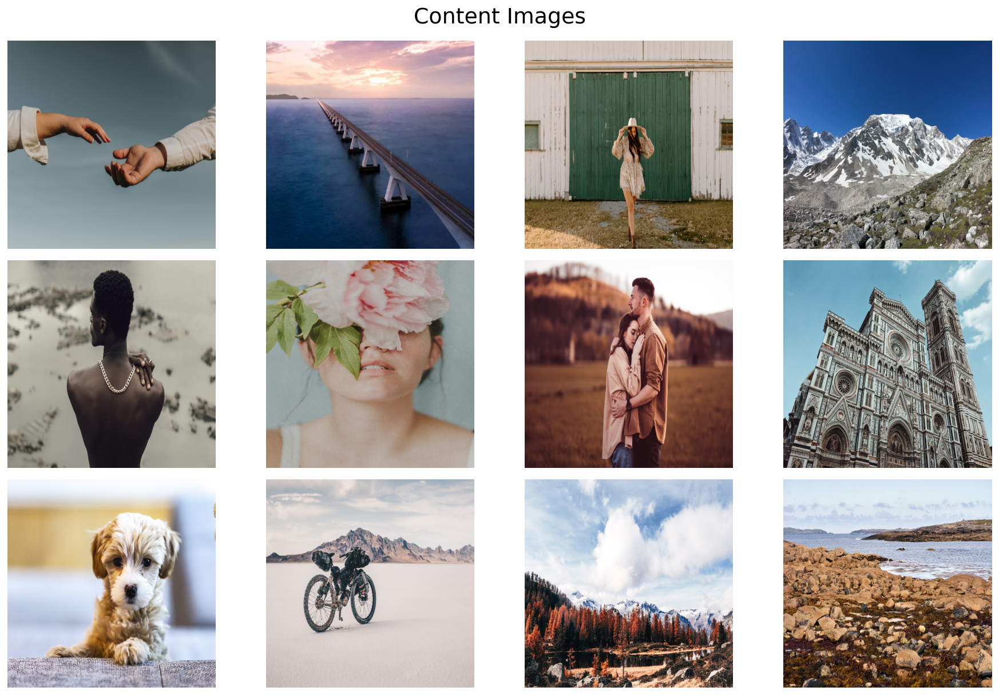

In [ ]:
fig, axs = plt.subplots(3, 4)
path = '/content/gdrive/MyDrive/Data/Content'
index = 1
for i in range(3):
  for j in range(4):
    if j%2==0:
      img_path = f'{path}/{index}.jpg'
      # image=Image.open(img_path)
      image = cv2.imread(img_path)
      image = cv2.resize(image, (500, 500)) 
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axs[i, j].imshow(image)
      axs[i, j].axis('off')
    elif j%2!=0:
      img_path = f'{path}/{index}.jpg'
      # image=Image.open(img_path)
      image = cv2.imread(img_path)
      image = cv2.resize(image, (500, 500)) 
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axs[i, j].imshow(image)   
      axs[i, j].axis('off')
    index +=1 
plt.suptitle("Content Images", fontsize=21, y=1.033)
plt.subplots_adjust(wspace=-0.55) 
plt.tight_layout()

## Style Images

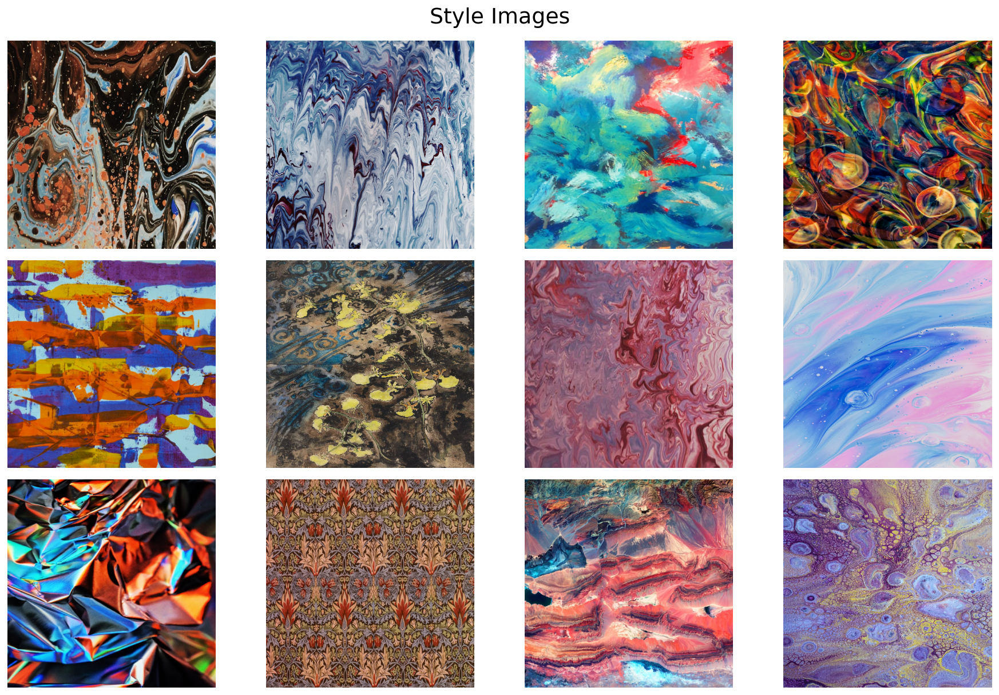

In [ ]:
fig, axs = plt.subplots(3, 4)
path = '/content/gdrive/MyDrive/Data/Painting'
index = 1
for i in range(3):
  for j in range(4):
    if j%2==0:
      img_path = f'{path}/{index}.jpeg'
      # image=Image.open(img_path)
      image = cv2.imread(img_path)
      image = cv2.resize(image, (500, 500)) 
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axs[i, j].imshow(image)
      axs[i, j].axis('off')
    elif j%2!=0:
      img_path = f'{path}/{index}.jpeg'
      # image=Image.open(img_path)
      image = cv2.imread(img_path)
      image = cv2.resize(image, (500, 500)) 
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axs[i, j].imshow(image)   
      axs[i, j].axis('off')
    index +=1  
plt.suptitle("Style Images", fontsize=21, y=1.033)
plt.subplots_adjust(wspace=-0.55) 
plt.tight_layout()

## Setting Up The Device 

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Building Dataset

In [ ]:
class ImageDataset(Dataset):
  def __init__(self, path, transform=None):
    self.path = path 
    self.images_list = [image for image in listdir(path) if isfile(join(path, image))]
    self.transform = transform

  def __len__(self):
    return len(self.images_list)

  def __getitem__(self, index):
    image_path = join(self.path, self.images_list[index])
    img = Image.open(image_path)
    

    if self.transform:
      img = self.transform(img)
    img = img.unsqueeze(0)
    img = img.to(device,torch.float)
    return img

In [ ]:
transform = transforms.Compose([transforms.Resize((500,500)), transforms.ToTensor()])

In [ ]:
Content_Images = ImageDataset(path='/content/gdrive/MyDrive/Data/Content/', transform=transform)
Style_Images = ImageDataset(path='/content/gdrive/MyDrive/Data/Painting/', transform=transform)

## Loading The Model

In [ ]:
model = models.vgg19(pretrained=True).features

## Building The Model To Perform Neural Style Transfer

In [ ]:
class VGG(nn.Module):
  def __init__(self):
    super(VGG, self).__init__()
    self.req_features = ['0', '5', '10', '19', '28']
    self.model = models.vgg19(pretrained=True).features[:29]

  def forward(self, x):
    features = []
    for layer_num, layer in enumerate(self.model):
      x = layer(x)
      if (str(layer_num) in self.req_features):
        features.append(x)

    return features

## Content And Style Loss

In [ ]:
def cal_content_loss(gen_feat, orig_feat):
  content_loss = torch.mean((gen_feat-orig_feat)**2)
  return content_loss

def cal_style_loss(gen, style):
  batch_size, channel, height, width = gen.shape

  G = torch.mm(gen.view(channel, height*width), gen.view(channel, height*width).t())
  S = torch.mm(style.view(channel, height*width), style.view(channel, height*width).t())

  style_loss = torch.mean((G-S)**2)
  return style_loss

## Total Loss

In [ ]:
def calculate_loss(gen_features, orig_features, style_features):
  style_loss = content_loss = 0
  for gen, cont, style in zip(gen_features, orig_features, style_features):
    content_loss += cal_content_loss(gen, cont)
    style_loss += cal_style_loss(gen, style)

  total_loss = alpha*content_loss + beta*style_loss
  return total_loss  

## Hyperparameter

In [ ]:
model = VGG().to(device).eval()

epochs = 401
lr = 0.004
alpha = 8
beta = 70
img_num = 1

In [ ]:
from tqdm.notebook import tqdm

## Training The Model

In [ ]:
for original_image, style_image in zip(Content_Images, Style_Images):
  generated_image = original_image.clone().requires_grad_(True)
  optimizer = optim.Adam([generated_image], lr=lr)

  print(f'Model is working on image: {img_num}')
  for epoch in tqdm(range(epochs)):
    generated_image = generated_image.to(device)
    original_image = original_image.to(device)
    style_image = style_image.to(device)

    gen_features=model(generated_image)
    orig_feautes=model(original_image)
    style_featues=model(style_image)
    
    total_loss=calculate_loss(gen_features, orig_feautes, style_featues)
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()

    if epoch != 0 and epoch%100==0:
        print(f'Epoch Number: {epoch} | Loss: {total_loss/epoch}')
        save_image(generated_image,f"/content/Gen_Images/gen{img_num}_{epoch}.png")
        print(f'Saved The Image Successfully !!')
  img_num = img_num + 1

Model is working on image: 1


Epoch Number: 100 | Loss: 1747727.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 595925.0625
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 316919.6875
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 198257.3125
Saved The Image Successfully !!

Model is working on image: 2


Epoch Number: 100 | Loss: 20689544.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 882427.8125
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 296502.3125
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 143060.75
Saved The Image Successfully !!

Model is working on image: 3


Epoch Number: 100 | Loss: 14628600.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 2645131.5
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 784655.3125
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 316177.1875
Saved The Image Successfully !!

Model is working on image: 4


Epoch Number: 100 | Loss: 15735466.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 5022419.0
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 2217030.0
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 1123085.0
Saved The Image Successfully !!

Model is working on image: 5


Epoch Number: 100 | Loss: 5252273.5
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 1970709.75
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 1045152.5625
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 618558.0625
Saved The Image Successfully !!

Model is working on image: 6


Epoch Number: 100 | Loss: 14001276.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 2786399.25
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 687571.8125
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 284136.71875
Saved The Image Successfully !!

Model is working on image: 7


Epoch Number: 100 | Loss: 14518140.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 4048270.75
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 1876013.25
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 1033871.5625
Saved The Image Successfully !!

Model is working on image: 8


Epoch Number: 100 | Loss: 12220896.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 2594719.5
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 884832.875
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 409353.34375
Saved The Image Successfully !!

Model is working on image: 9


Epoch Number: 100 | Loss: 1060792.75
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 284477.0
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 116277.7109375
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 60679.7421875
Saved The Image Successfully !!

Model is working on image: 10


Epoch Number: 100 | Loss: 13810104.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 3120409.25
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 1197194.875
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 588642.6875
Saved The Image Successfully !!

Model is working on image: 11


Epoch Number: 100 | Loss: 1776033.25
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 454510.0625
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 224899.71875
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 140863.984375
Saved The Image Successfully !!

Model is working on image: 12


Epoch Number: 100 | Loss: 1761795.0
Saved The Image Successfully !!
Epoch Number: 200 | Loss: 528342.4375
Saved The Image Successfully !!
Epoch Number: 300 | Loss: 242796.078125
Saved The Image Successfully !!
Epoch Number: 400 | Loss: 131132.734375
Saved The Image Successfully !!



## Results

In [3]:
plt.rcParams['figure.dpi'] = 140
plt.rcParams["figure.figsize"] = (20,8)

## Paintings

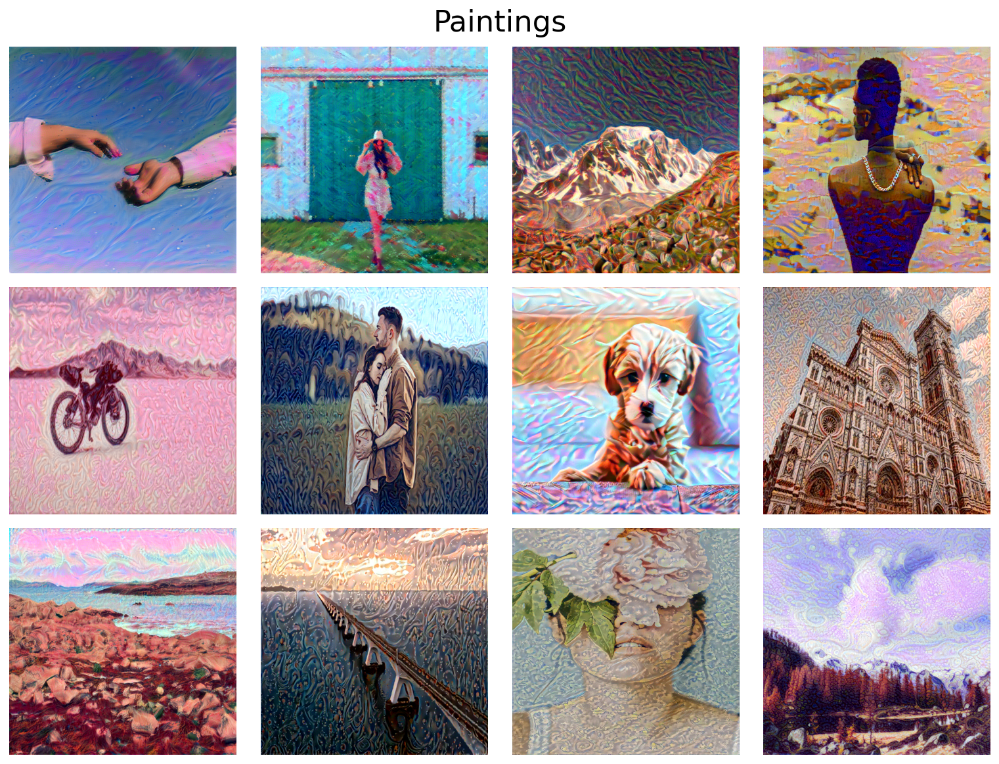

In [4]:
fig, axs = plt.subplots(3, 4)
path = '/content/Gen_Images'
index = 1
for i in range(3):
  for j in range(4):
    if j%2==0:
      img_path = f'{path}/gen{index}_400.png'
      # image=Image.open(img_path)
      image = cv2.imread(img_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axs[i, j].imshow(image)
      axs[i, j].axis('off')
    elif j%2!=0:
      img_path = f'{path}/gen{index}_400.png'
      # image=Image.open(img_path)
      image = cv2.imread(img_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axs[i, j].imshow(image)   
      axs[i, j].axis('off')
    index +=1  
plt.suptitle("Paintings", fontsize=23, y=1.033)
plt.subplots_adjust(wspace=-0.85) 
plt.tight_layout()

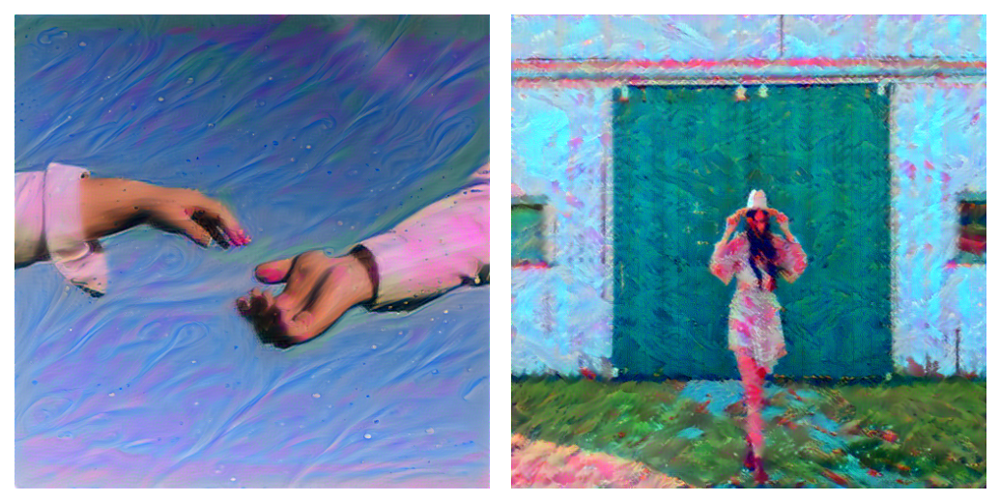

In [ ]:
plt.rcParams["figure.figsize"] = (7,5)
plt.rcParams['figure.dpi'] = 150
img_path = '/content/Gen_Images/gen1_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,1)
plt.imshow(image)
plt.axis('off')

img_path = '/content/Gen_Images/gen2_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,2)
plt.imshow(image)
plt.axis('off')
#plt.subplots_adjust(wspace=-1) 
plt.tight_layout()
plt.show()

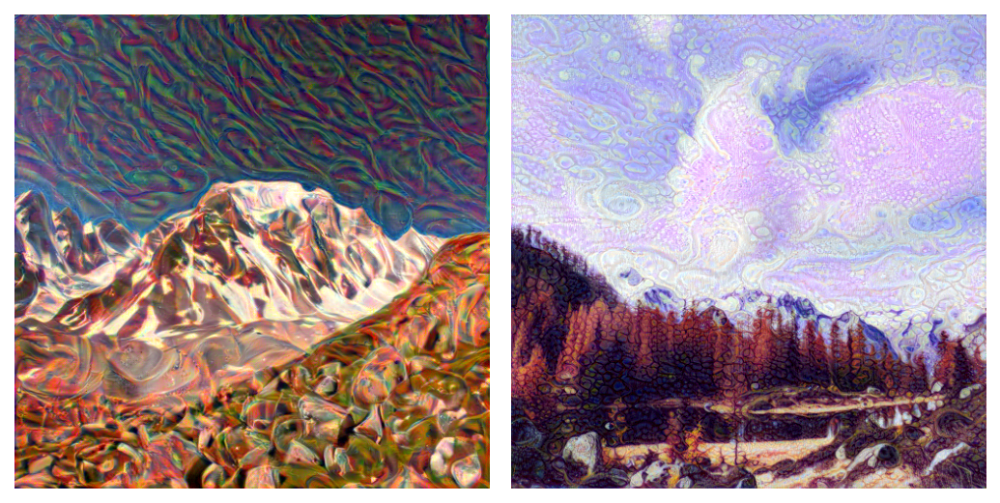

In [ ]:
plt.rcParams["figure.figsize"] = (7,5)
plt.rcParams['figure.dpi'] = 150
img_path = '/content/Gen_Images/gen3_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,1)
plt.imshow(image)
plt.axis('off')

img_path = '/content/Gen_Images/gen12_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,2)
plt.imshow(image)
plt.axis('off')
#plt.subplots_adjust(wspace=-1) 
plt.tight_layout()
plt.show()

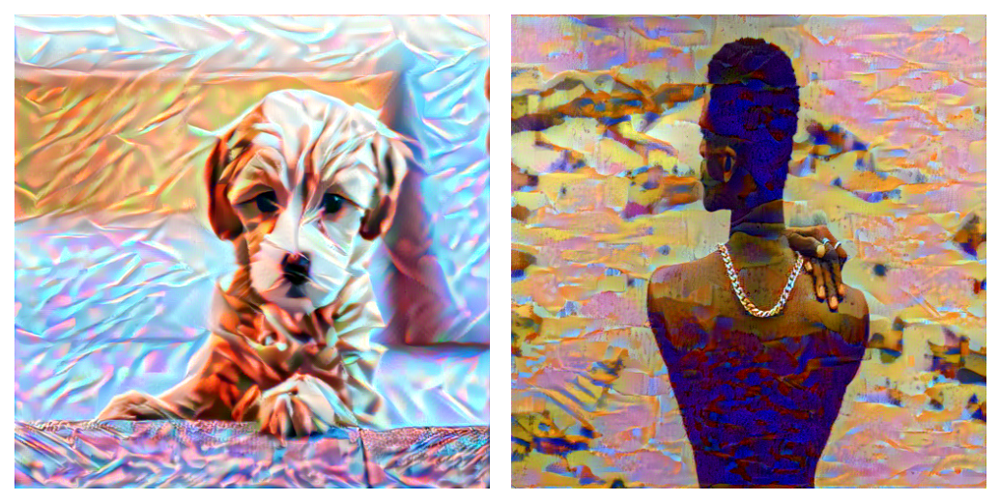

In [ ]:
plt.rcParams["figure.figsize"] = (7,5)
plt.rcParams['figure.dpi'] = 150
img_path = '/content/Gen_Images/gen7_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,1)
plt.imshow(image)
plt.axis('off')

img_path = '/content/Gen_Images/gen4_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,2)
plt.imshow(image)
plt.axis('off')
#plt.subplots_adjust(wspace=-1) 
plt.tight_layout()
plt.show()

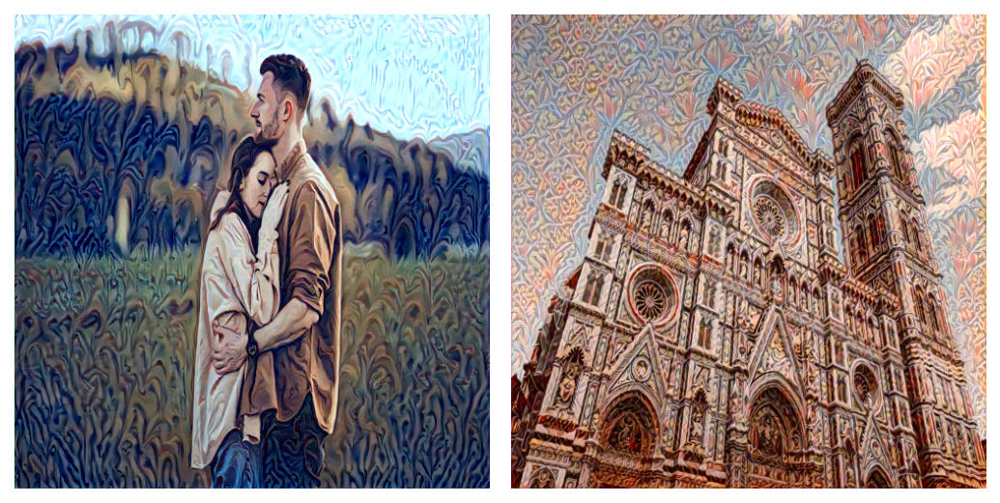

In [ ]:
plt.rcParams["figure.figsize"] = (7,5)
plt.rcParams['figure.dpi'] = 150
img_path = '/content/Gen_Images/gen6_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,1)
plt.imshow(image)
plt.axis('off')

img_path = '/content/Gen_Images/gen8_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,2)
plt.imshow(image)
plt.axis('off')
#plt.subplots_adjust(wspace=-1) 
plt.tight_layout()
plt.show()

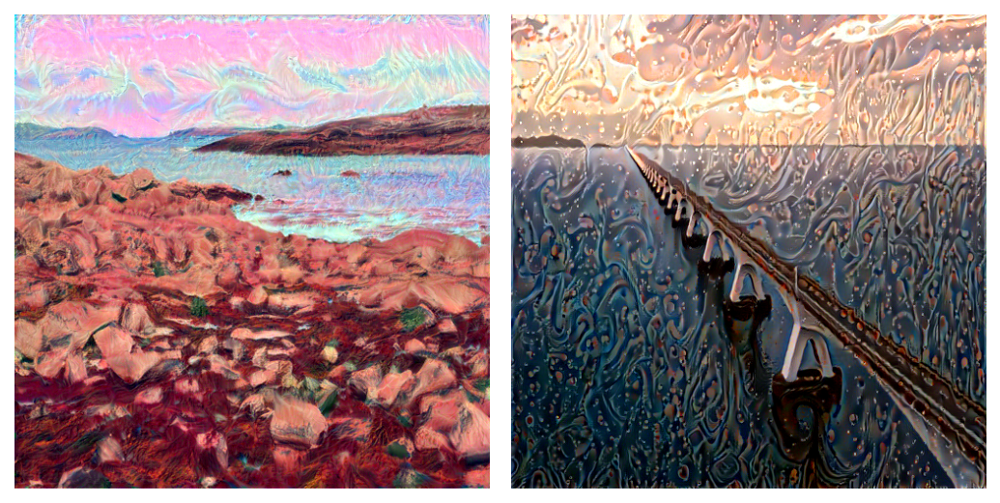

In [ ]:
plt.rcParams["figure.figsize"] = (7,5)
plt.rcParams['figure.dpi'] = 150
img_path = '/content/Gen_Images/gen9_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,1)
plt.imshow(image)
plt.axis('off')

img_path = '/content/Gen_Images/gen10_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,2)
plt.imshow(image)
plt.axis('off')
#plt.subplots_adjust(wspace=-1) 
plt.tight_layout()
plt.show()

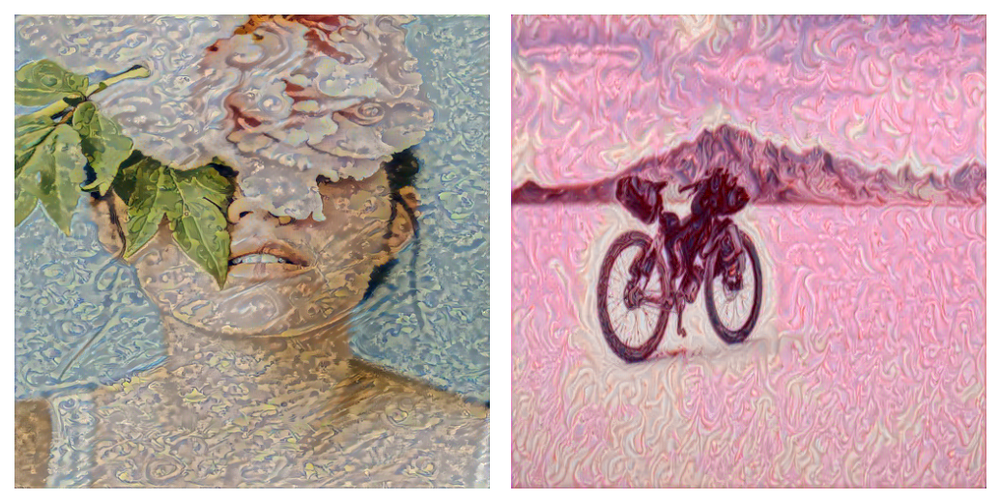

In [ ]:
plt.rcParams["figure.figsize"] = (7,5)
plt.rcParams['figure.dpi'] = 150
img_path = '/content/Gen_Images/gen11_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,1)
plt.imshow(image)
plt.axis('off')

img_path = '/content/Gen_Images/gen5_400.png'
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

ax = plt.subplot(1,2,2)
plt.imshow(image)
plt.axis('off')
#plt.subplots_adjust(wspace=-1) 
plt.tight_layout()
plt.show()